# Detecting objects with SSD VGG16 on Coco dataset using PyTorch and OpenCV

Using torchvision, we load the [SSD model](https://arxiv.org/pdf/1512.02325.pdf) with vgg16 architecture, trained on Coco dataset. With the pre-trained model, we build a detector to extract the bound boxes, class prediction and confidence. OpenCV is used to print out the box and predictions.

In [1]:
from PIL import Image
import matplotlib.pyplot as plt
import torch
import torchvision.transforms as T
import torchvision
import torch
import numpy as np
import cv2
import os
import imutils
from imutils import paths

## Setting the model

We load the model using torchvision.models.detection that contains a considerable number of object detection models and, model.eval() to be able to make inferences.

In [2]:
model = torchvision.models.detection.ssd300_vgg16(pretrained=True) # loading model
model.eval() #setting the model to inferences

SSD(
  (backbone): SSDFeatureExtractorVGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inplace=

**Setting the classes from COCO dataset**

The full list of the COCO objects is [found here](https://tech.amikelive.com/node-718/what-object-categories-labels-are-in-coco-dataset/).

In [3]:
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

**Defining the function to predict on images**

Differently from the dnn module from OpenCV, make detection with torchvision requires some steps:

- Set the image with Image from PIL
- Define a transform to transform the input image into a tensor
- Covert the image into a tensor
- Make predictions using the pre-trained model
- Make a list with all class predicted 
- Extract the bounding box coordinates
- Make a list with all confidences relative to the detection
- Select the confidence according with an attributed threshold
- Extract the bounding box coordinates from the list of the best predicted confidences
- Extract the class from the list of the best predicted confidences
- Extract the confidences from list of the best predicted confidences
- return the boxes predictions, class prediction and their confidences

In [4]:
def get_prediction(img_path, threshold):
    """
      get_prediction
        parameters:
          - img_path - path of the input image
          - threshold - threshold value for prediction score
        method:
          - Image is obtained from the image path
          - the image is converted to image tensor using PyTorch's Transforms
          - image is passed through the model to get the predictions
          - class, box coordinates are obtained, but only prediction score > threshold
            are chosen.

    """
    img = Image.open(img_path)
    transform = T.Compose([T.ToTensor()])
    img = transform(img)
    pred = model([img])
    pred_class = [COCO_INSTANCE_CATEGORY_NAMES [i] for i in list(pred[0]['labels'].numpy())]
    pred_boxes = [[(i[0].astype("int"), i[1].astype("int")), (i[2].astype("int"), i[3].astype("int"))] for i in list(pred[0]['boxes'].detach().numpy())]
    pred_score = list(pred[0]['scores'].detach().numpy())
    pred_t = [pred_score.index(x) for x in pred_score if x>threshold][-1]
    pred_boxes = pred_boxes[:pred_t+1]
    pred_class = pred_class[:pred_t+1]
    scores = pred_score[: pred_t+1]
    
    return pred_boxes, pred_class, scores

**Defining the function to print out the detected objects**

This function calls the get_prediction function. From the values passed by get_prediction functions, we utilize OpenCV to make the boxes, printing out the class and confidence.

In [5]:
def object_detection(img_path, threshold=0.5, rect_th=3, text_size=0.8, text_th=2):
    """object_detection function to print out all detection in an image
    args:
        img_path: path to the image
        threshold: minimal values acceptable for the confidence
        rect_th: thickness of the printed box
        text_size: size of the text
        text_th: thickness of the text
    This function returns the image with the predictions 
    """
    boxes, pred_cls, scores = get_prediction(img_path, threshold)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    for i in range(len(boxes)):
        
        cv2.rectangle(img, (boxes[i][0]), (boxes[i][1]), (255, 0, 0), 1)
        text = "{}: {:.4f}".format(pred_cls[i],  scores[i])
        cv2.putText(img, text, boxes[i][0], cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,255,0),thickness=text_th)
    
    return img

**Setting the paths of all images**

In [6]:
dataset = "../dataset/images"
pathImages = list(paths.list_images(dataset))

## Making detections

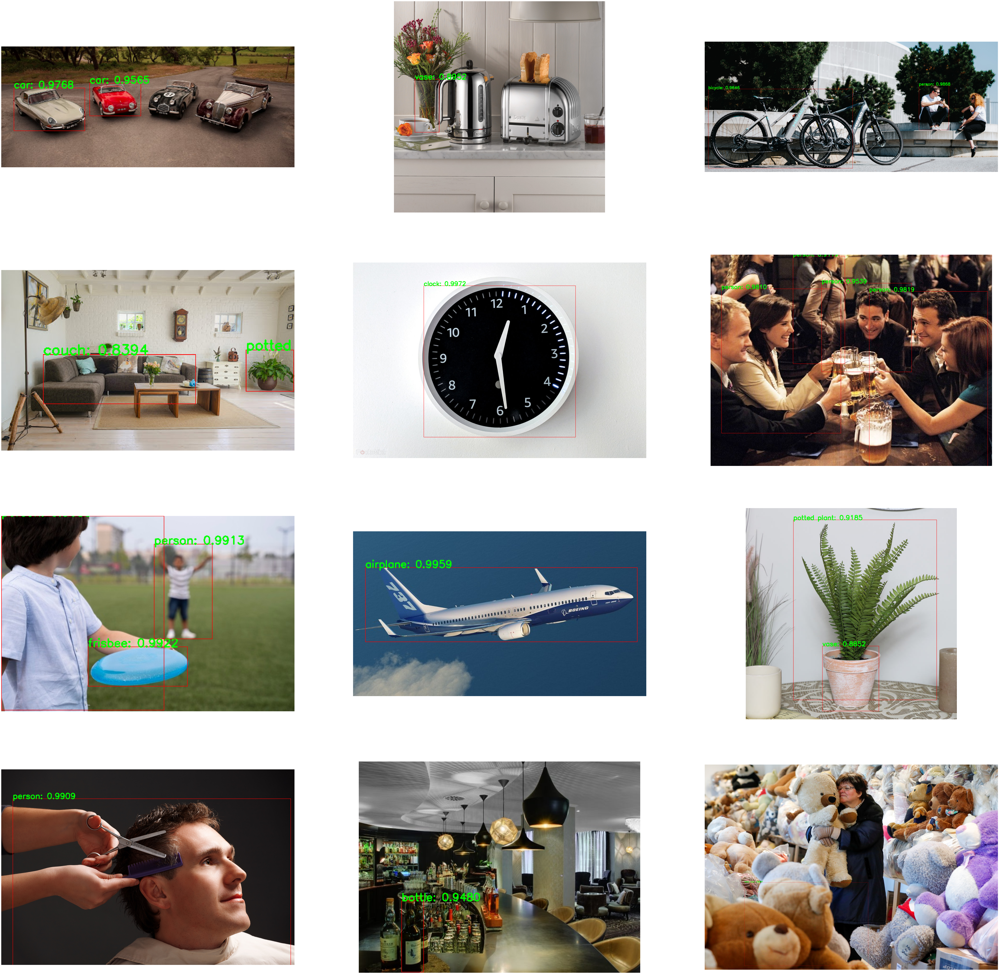

In [7]:
plt.figure(figsize=(100,100))
count = 1
for img in pathImages:
    
    image = object_detection(img, threshold=0.8)
    ax = plt.subplot(4, 3, count)
    plt.imshow(image)
    plt.axis("off")
    count += 1
plt.show()

## Conclusion

Using this pre-trained model, the SSD made some detection and, didn't see some objects, specially small objects. SSD model is a state-of-art model, when well tuned, it can corresponds to the requirements of the task.  On the other hand, if the speed of detection is important for the problem, YOLO is always better.